In [1]:
import seaborn as sns
from collections import defaultdict
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
from os import path
from scipy.stats import wilcoxon

In [10]:
dimensions = [30]
ROOTPATH = f'/home/rcls/codigos/git-projects/analysis-volitive-gwo/results/'
algorithm = 'VGWO'
steps = [0.1, 0.01, 0.001]
STEPS = [str(step).replace('.', '_') for step in steps]

max_iter = 1000
num_agents = 30
max_eval = num_agents * max_iter + num_agents
multimodal_functions = ['Rastrigin','Generalized-Shwefel', "Ackley", "Levy", "Griewank"]
unimodal_functions = ['Sphere','RotatedHyperEllipsoid', "Rosenbrock", "Dixon-Price", "Quartic-Noise"]
functions = multimodal_functions + unimodal_functions
simulations = 20
name=f"%s_dim_%d_agents_%d_iter_%d_eval_%d_step_%s_%s_%s.csv"

In [11]:
results = defaultdict(dict)

for dimension in dimensions:
    results[dimension] = defaultdict(dict)
    
    for func in functions:
        results[dimension][func] = defaultdict(dict)
        for step_str in STEPS:    
            filename = name % (algorithm, dimension, num_agents, max_iter, max_eval, step_str, func, "convergence")
            df = pd.read_csv(ROOTPATH+filename)
            #results[dimension][func][algo] = df
            df.drop(columns=['Unnamed: 0'], axis=1, inplace=True)
            for simulation in range(simulations):
                results[dimension][func][step_str][simulation] = df[f'convergence_simulation_{simulation}'].tolist()[0:max_iter]        


In [12]:
results_eval = defaultdict(dict)

for dimension in dimensions:
    results_eval[dimension] = defaultdict(dict)
    
    for func in functions:
        results_eval[dimension][func] = defaultdict(dict)
        for step_str in STEPS:    
            filename = name % (algorithm, dimension, num_agents, max_iter, max_eval, step_str, func, "evaluations")
            df = pd.read_csv(ROOTPATH+filename)
            #results[dimension][func][algo] = df
            df.drop(columns=['Unnamed: 0'], axis=1, inplace=True)
            for simulation in range(simulations):
                results_eval[dimension][func][step_str][simulation] = df[f'eval_simulation_{simulation}'].tolist()


In [13]:
results

defaultdict(dict,
            {30: defaultdict(dict,
                         {'Rastrigin': defaultdict(dict,
                                      {'0_1': {0: [318.0896372599368,
                                         317.7149968109906,
                                         260.24086725426804,
                                         244.46925873876492,
                                         223.15826295572987,
                                         215.0197468130248,
                                         189.71593750966227,
                                         96.04270385049134,
                                         96.04270385049134,
                                         69.9070138695925,
                                         61.48733812317553,
                                         30.14636419453643,
                                         21.09998354903809,
                                         3.5560364446888,
                                       

# Data Transform

In [14]:
database_convergence = pd.DataFrame({'Fitness': [], 'Dimension': [], 'Evaluation': []})
for dimension in dimensions:
    for func in results_eval[dimension]:
        for step_str in results_eval[dimension][func]:
            for simulation in results_eval[dimension][func][step_str]:
                rows_len = len(results_eval[dimension][func][step_str][simulation]) 
                temp_database = pd.DataFrame({'Evaluation': list(range(0, rows_len)), 'Step': [step_str.replace('_', '.')]*rows_len, 'Function': [func]*rows_len, 'Dimension': [dimension]*rows_len, 'Simulation': [simulation]*rows_len, 'Fitness': results_eval[dimension][func][step_str][simulation]})
                #database = database.append(new_row, ignore_index=True)
                database_convergence = pd.concat((database_convergence, temp_database))

database_convergence.reset_index(drop=True, inplace=True)

database_convergence['Dimension'] = database_convergence['Dimension'].astype(int)
database_convergence['Evaluation'] = database_convergence['Evaluation'].astype(int)
database_convergence['Simulation'] = database_convergence['Simulation'].astype(int)                    

In [15]:
database_convergence

,Fitness,Dimension,Evaluation,Step,Function,Simulation
0,528.273796,30,0,0.1,Rastrigin,0
1,528.273796,30,1,0.1,Rastrigin,0
2,528.273796,30,2,0.1,Rastrigin,0
3,528.273796,30,3,0.1,Rastrigin,0
4,528.273796,30,4,0.1,Rastrigin,0
...,...,...,...,...,...,...
18017995,0.000183,30,30025,0.001,Quartic-Noise,19
18017996,0.000183,30,30026,0.001,Quartic-Noise,19
18017997,0.000183,30,30027,0.001,Quartic-Noise,19
18017998,0.000183,30,30028,0.001,Quartic-Noise,19


In [16]:
#database = pd.DataFrame({'Fitness': [], 'Dimension': [], 'Iteration': []})
list_rows = []
for dimension in dimensions:
    for func in results[dimension]:
        for step_str in results[dimension][func]:
            for simulation in results[dimension][func][step_str]:
                rows_len = len(results[dimension][func][step_str][simulation]) 
                #temp_database = pd.DataFrame({'Iteration': rows_len, 'Algorithm': algo, 'Function': func, 'Dimension': dimension, 'Simulation': simulation, 'Fitness': results[dimension][func][algo][simulation][-1]})
                list_rows.append({'Iteration': rows_len, 'Step': step_str.replace('_', '.'), 'Function': func, 'Dimension': dimension, 'Simulation': simulation, 'Fitness': results[dimension][func][step_str][simulation][-1]})
                #database = database.append(new_row, ignore_index=True)
                #database = pd.concat((database, temp_database))

database = pd.DataFrame.from_records(list_rows)
database.reset_index(drop=True, inplace=True)

database['Dimension'] = database['Dimension'].astype(int)
database['Iteration'] = database['Iteration'].astype(int)
database['Simulation'] = database['Simulation'].astype(int)                    

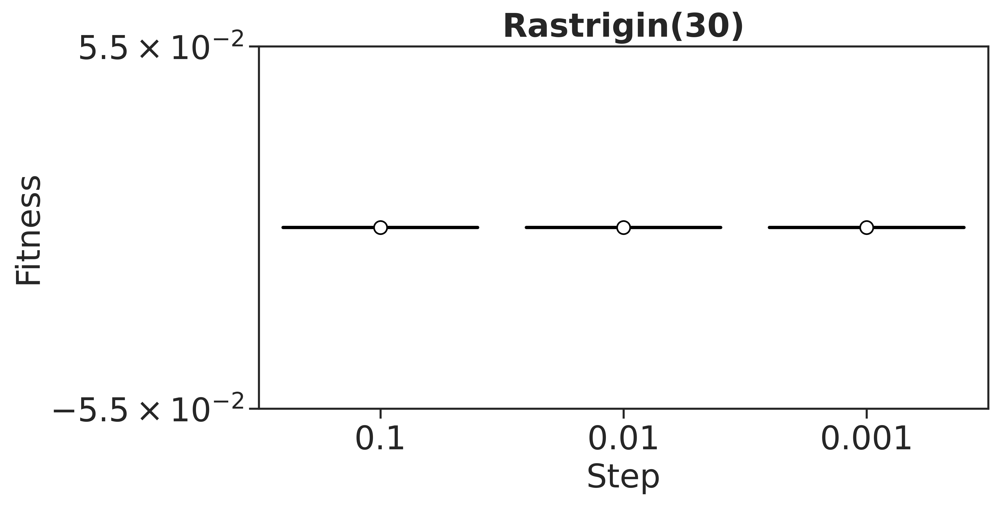

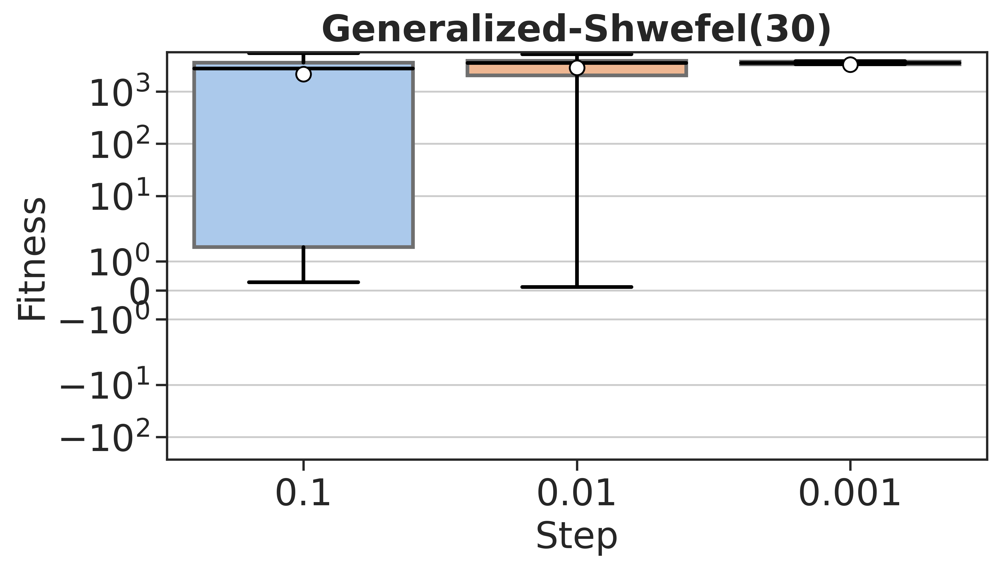

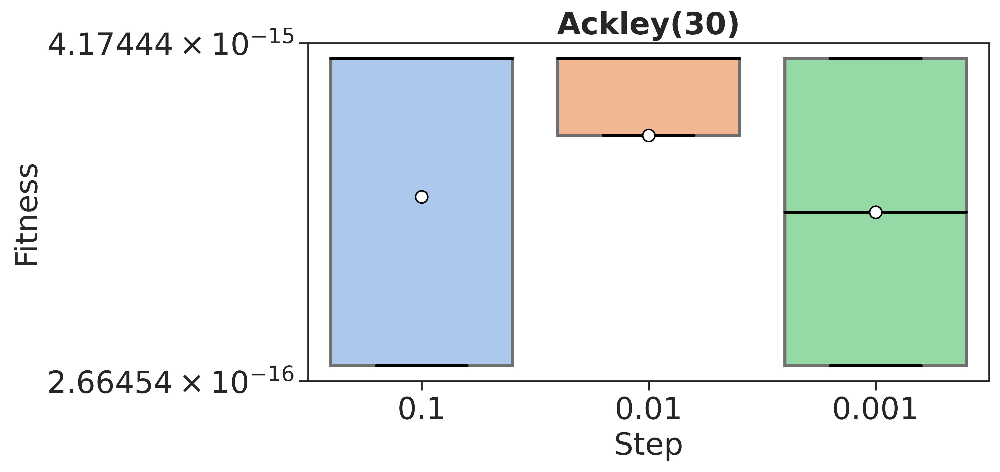

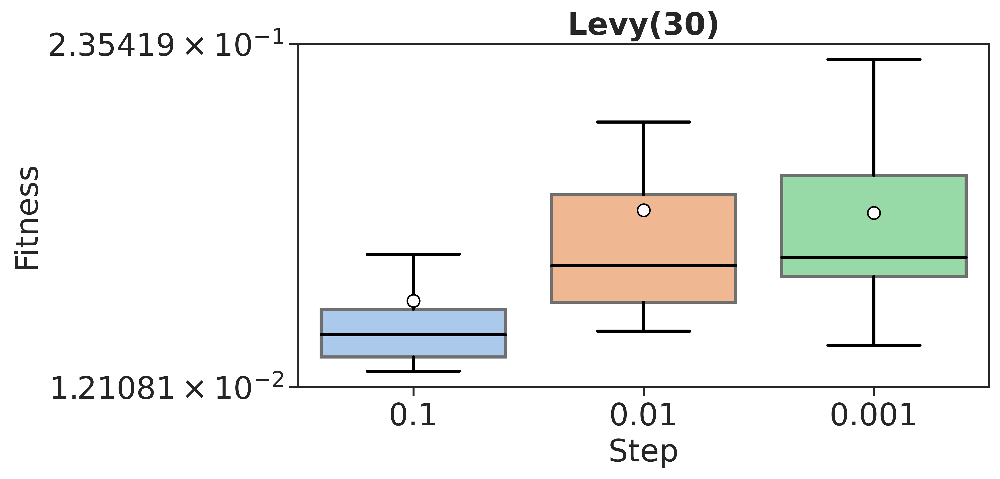

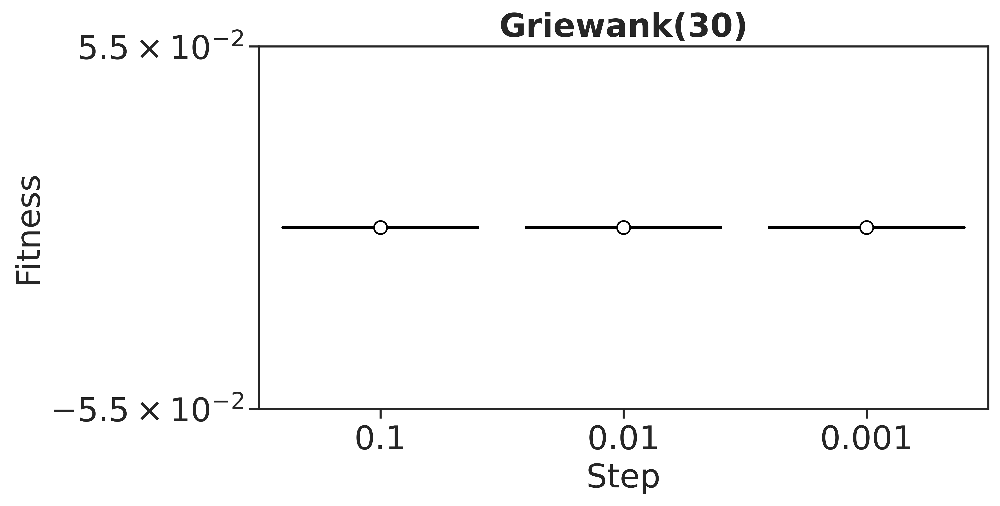

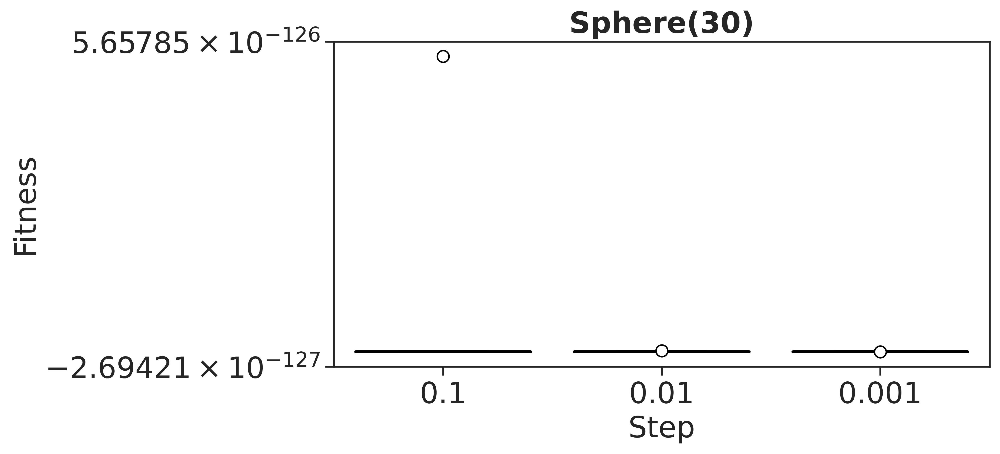

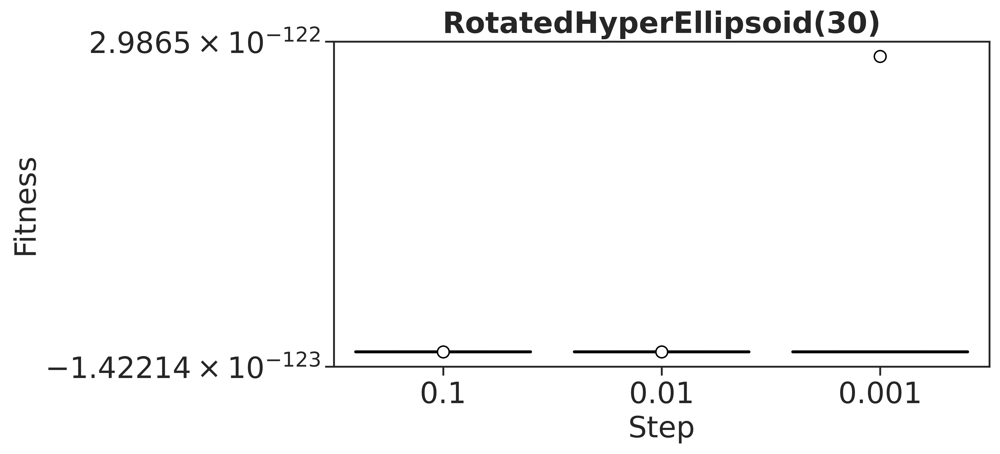

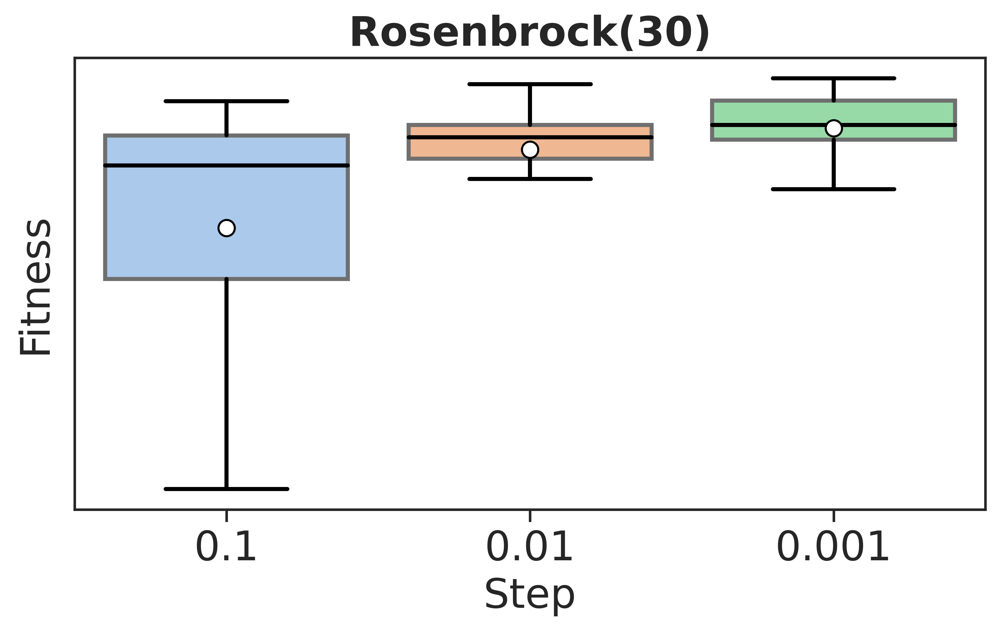

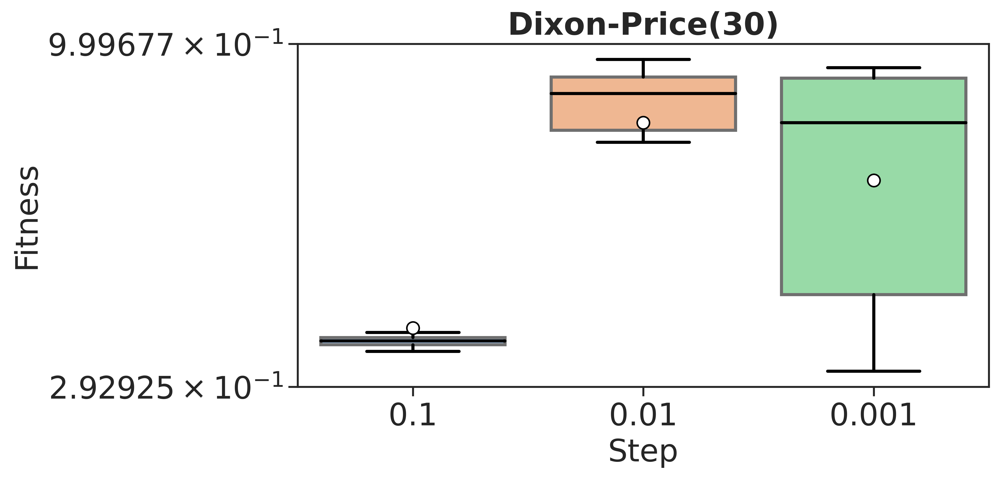

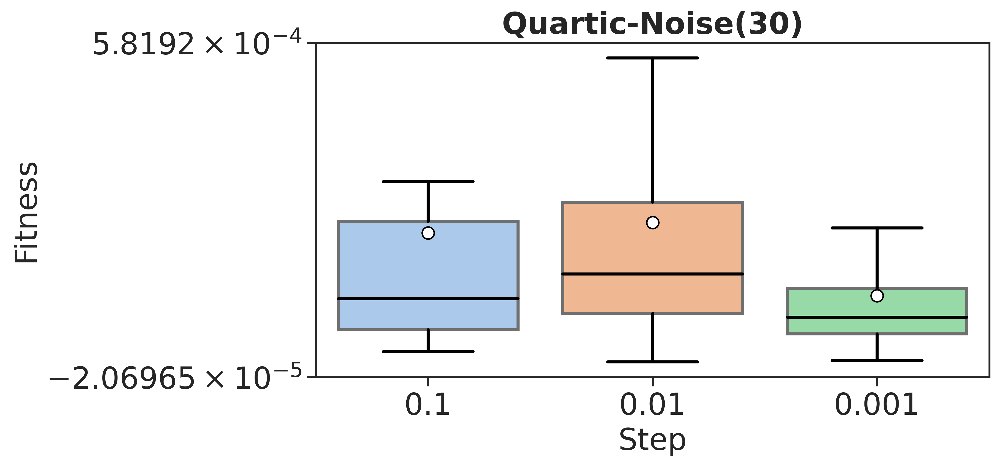

In [17]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})

PROPS = {  
    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'black'},
    'capprops':{'color':'black'}
}

MEANPROPS={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                      "markersize":"8"}

sns.set_style("ticks")
sns.set_theme(style="ticks", palette="pastel")
label_size = 20
#plt.rc('legend', fontsize = label_size)

for function in functions:
    fig, ax = plt.subplots(figsize=(8,4)) #13,8
    df_filtered_func = database[database['Function'] == function]
    for pos, dimension in enumerate(dimensions):
        
        #ax.ticklabel_format(axis="x", style="sci", scilimits=(0,0))
        
        df_filteres = df_filtered_func[df_filtered_func['Dimension'] == dimension]
        #print(df_filteres)
        #input()
        b = sns.boxplot(x='Step',  data=df_filteres, y='Fitness', hue=f'Step', showfliers=False, 
                    orient = 'v', ax = ax, width=0.8, linewidth = 2, **PROPS, showmeans=True, meanprops=MEANPROPS
                       ,dodge = False)
        
        #if function == "Rastrigin":
        #    function_name = function
        #elif function == "F3_MODIFIED":
        #    function_name = "F3"
            
        ax.set_title(f"{function}({dimension})", fontsize=label_size, fontweight="bold")
        ax.legend_.remove()

        #if pos == 1:
        #    ax.set(ylabel=None)
        
        #if function not in ["ShiftedRastrigin", "ShiftedRotatedRastrigin"]:
        ax.set_yscale("symlog")
            
        ax.yaxis.grid(True) # Hide the horizontal gridlines
        ax.xaxis.grid(False)
        #ax[pos].xaxis.grid(True) # Show the vertical gridlines
        #ax.ticklabel_format(axis="x", style="sci", scilimits=(0,0))
        #plt.legend(loc='upper right')

        #sns.despine(offset=5, trim=True)        
        ax.xaxis.set_tick_params(labelsize = label_size)
        ax.yaxis.set_tick_params(labelsize = label_size)
        ax.set_xlabel(ax.get_xlabel(), fontsize=label_size)
        ax.set_ylabel(ax.get_ylabel(), fontsize=label_size)



# Convergence

In [ ]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})

PROPS = {

    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'black'},
    'capprops':{'color':'black'}
}

label = ord('A')
font_size_out = 10
sns.set_theme(style="ticks", palette="pastel")

for lin, dim in enumerate(dimensions):
    df_dim = database_convergence[database_convergence['Dimension'] == dim]
    for col, function in enumerate(functions):
        fig, ax = plt.subplots(figsize = (8, 4))
        fig.subplots_adjust(wspace=0.1, hspace=0.2)
        ax.get_xaxis().get_offset_text().set_position((0.5,0))
        
            
        ax.set_title(f"{function}({dim})", fontsize=15, fontweight="bold")
        my_y = 1.05
        my_x = 0.1

        ax.text(my_x, my_y,f"{chr(label)}",fontsize=font_size_out*1.2,transform=ax.transAxes, weight="bold")
        
        df_filtered = df_dim[df_dim['Function'] == function]        
        sns.lineplot(x='Evaluation', data=df_filtered, y="Fitness", hue='Step', ax = ax, 
                    markers = ['o', 'v', '^', '>'], markersize = 10, linewidth = 3, style = 'Step',
                    markevery=1500, errorbar=None)
        
        
        ax.yaxis.grid(True) # Hide the horizontal gridlines
        ax.xaxis.grid(False)
        #ax[col].set_ylabel(ylabeltext, fontsize=15)
        ax.set_yscale("symlog")

#        if (col == 1):
#            ax.set_ylabel("", fontsize=15)  

        #ax[col].set_xlabel(xlabeltext, fontsize=15)
        #ax[col].ticklabel_format(axis="y", style="sci", scilimits=(0,0))
        
        ax.set_xticks(range(0, max_eval+100, 1500)) # <--- set the ticks `
        ax.set_xticklabels(ax.get_xticks(), rotation = 45)

        plt.rc('legend', fontsize = 8)
        label+=1         

/tmp/ipykernel_25171/2307152640.py:29: UserWarning: The markers list has more values (4) than needed (3), which may not be intended.
  sns.lineplot(x='Evaluation', data=df_filtered, y="Fitness", hue='Step', ax = ax,
/tmp/ipykernel_25171/2307152640.py:29: UserWarning: The markers list has more values (4) than needed (3), which may not be intended.
  sns.lineplot(x='Evaluation', data=df_filtered, y="Fitness", hue='Step', ax = ax,
/tmp/ipykernel_25171/2307152640.py:29: UserWarning: The markers list has more values (4) than needed (3), which may not be intended.
  sns.lineplot(x='Evaluation', data=df_filtered, y="Fitness", hue='Step', ax = ax,


# Wilcoxon

In [ ]:
proposal = "0.1"

In [ ]:
alpha = 0.05

dicionario_wilcoxon = defaultdict(dict)

for dimension in dimensions:
    print(f'\n{dimension} dimensions')
    for func in functions:
        print(f'\n\t{func}({dimension})')
        proposal_results = [results[dimension][func][proposal][simulation_id][-1]
         for simulation_id in results[dimension][func][proposal]]
        mean_proposal = np.mean(proposal_results)
        print(f'\t{mean_proposal} ({np.std(proposal_results)})')
        dicionario_wilcoxon[dimension][func] = defaultdict(dict)
        dicionario_wilcoxon[dimension][func][proposal] = {'mean': mean_proposal, 'std':  np.std(proposal_results), 'wilcoxon': '-'}
        
        for algo in results[dimension][func]:
            if algo == proposal:
                continue
                
            other_algo_results = [ results[dimension][func][algo][simulation_id][-1] for simulation_id in results[dimension][func][algo]]
            mean_other = np.mean(other_algo_results)
            try:
                stat, p = wilcoxon(np.absolute(proposal_results), np.absolute(other_algo_results))                
                print(f'{stat}, {p} ')
                print(f'\t\t{mean_other} ({np.std(other_algo_results)})' , end= '')
                print (f' | {proposal} x {algo}', end= '')
                
                if p > alpha:
                    dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': '--'}
                    print(' -> Same distribution (fail to reject H0) - ')
                else:                    
                    print(' -> Different distribution (reject H0) ', end='')
                    if mean_proposal < mean_other: # menor é melhor
                        dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': '$\\blacktriangle$'}
                        print(' proposal melhor')
                    elif mean_proposal > mean_other:
                        dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': '$\\blacktriangledown$'}
                        print(' proposal pior')
                    else:
                        dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': 'x'}
                        print(' proposal igual') # acho que isso não pode
                        
            except ValueError as err:
                    dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': 'error'}
                    print(err)                
        
        print("-".center(100,"-"))
